In [1]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')

res_df = pd.read_csv('../datasets/Zenodo/v1/ams_order_results.csv.gz')
train_df = pd.read_csv('../datasets/Zenodo/v1/train_ams_order_cluster.csv.gz')
train_df = train_df[train_df['dataset'] == 'train']

---
## Total Hits of Ordered Compounds

In [2]:
print('Total hits: {0:.0f} out of {1:.0f}. Hit Rate: {2:.2f} %'.format(res_df['Hit'].sum(), res_df.shape[0], 
                                                           100.0*(res_df['Hit'].sum()/res_df.shape[0])))

Total hits: 412 out of 1024. Hit Rate: 40.23 %


---
## Hits by Selection/Model Type

In [3]:
RF_all = res_df[res_df['Selection'].isin(['Prediction', 'Both'])]
BL_all = res_df[res_df['Selection'].isin(['Baseline', 'Both'])]
RF_but_not_BL = res_df[res_df['Selection'].isin(['Prediction'])]
BL_but_not_RF = res_df[res_df['Selection'].isin(['Baseline'])]
overlap_selection =  res_df[res_df['Selection'] == 'Both']

summary_by_selection = []
for df in [res_df, RF_all, BL_all, overlap_selection, RF_but_not_BL, BL_but_not_RF]:
    summary_by_selection.append([df.shape[0], df['Hit'].sum()])
    
index_names = ['RF-C + Baseline', 'RF-C', 'Baseline', 
               'RF-C AND Baseline (overlap)', 'RF-C - Baseline', 'Baseline - RF-C']
summary_df = pd.DataFrame(data=summary_by_selection,
                          columns=['Count', 'Hits'],
                          index=index_names)

summary_df['Misses'] = summary_df['Count'] - summary_df['Hits']
summary_df['Hit Rate'] = 100.0*(summary_df['Hits'] / summary_df['Count'])
summary_df

,Count,Hits,Misses,Hit Rate
RF-C + Baseline,1024,412,612,40.234375
RF-C,701,337,364,48.074180
Baseline,705,256,449,36.312057
RF-C AND Baseline (overlap),382,181,201,47.382199
RF-C - Baseline,319,156,163,48.902821
Baseline - RF-C,323,75,248,23.219814


- We can see that the RF model when given similar budget to the Baseline achieves a ~10% increase in hit rate (37.4% vs 48.4%). 
- RF and the baseline agree in selecting 382 cpds. Thus they agree on 183 of their hits. 
- RF selects 319 cpds not selected by the baseline. It finds 156 hits among these. 
- Baseline selects 323 cpds not selected by the RF. It finds 81 hits among these. 
- From the above, the RF manages to find 75 more hits than the baseline. 
- Need to see diversity/novelty of RF vs BL hits. 
---


## Look at clusers/novel hits

Unique cluster hits counts the number of unique clusters with hits in the prospective dataset.

Novel cluster hits counts the number of unique clusters with hits that were NOT present in the training set. In other words, clusters that the model was not trained on. 

In [4]:
train_hits = train_df[train_df['Hit'] == 1]

cluster_cols = ['TB_0.2 ID', 'TB_0.3 ID', 'TB_0.4 ID']
cluster_summary = []
for df in [res_df, RF_all, BL_all, overlap_selection, RF_but_not_BL, BL_but_not_RF]:
    ref_hits = df[df['Hit'] == 1]
    tmp_list = []
    for cluster_col in cluster_cols:
        cluster_hit_count = ref_hits[cluster_col].unique().shape[0]
        novel_cluster_count = np.setdiff1d(ref_hits[cluster_col].unique(), train_hits[cluster_col].unique()).shape[0]
        tmp_list.extend([cluster_hit_count, novel_cluster_count])
    cluster_summary.append(tmp_list)
cluster_hit_df = pd.DataFrame(data=cluster_summary,
                              columns=['Unique Cluster Hits (TB 0.2)', 'Novel Cluster Hits (TB 0.2)',
                                       'Unique Cluster Hits (TB 0.3)', 'Novel Cluster Hits (TB 0.3)',
                                       'Unique Cluster Hits (TB 0.4)', 'Novel Cluster Hits (TB 0.4)'],
                              index=index_names)
cluster_hit_df

,Unique Cluster Hits (TB 0.2),Novel Cluster Hits (TB 0.2),Unique Cluster Hits (TB 0.3),Novel Cluster Hits (TB 0.3),Unique Cluster Hits (TB 0.4),Novel Cluster Hits (TB 0.4)
RF-C + Baseline,351,304,242,138,169,72
RF-C,295,258,217,132,142,61
Baseline,200,153,124,21,115,30
RF-C AND Baseline (overlap),144,107,99,15,88,19
RF-C - Baseline,151,151,130,120,72,44
Baseline - RF-C,63,48,43,7,40,13


---
## Look at RF-C rank of compounds selected by the baseline but not RF-C

In [5]:
rank_rf_bl = BL_but_not_RF.sort_values('rf_rank')
rank_rf_bl[['rf_rank', 'Hit']]

,rf_rank,Hit
146,1778.0,0
198,1779.0,0
184,1793.0,0
1005,1801.0,1
472,1823.0,0
...,...,...
552,125144.0,0
548,151474.0,0
553,183252.0,0
791,185213.0,0


In [6]:
print('Top-2500 RF hit increase estimate: {} hits'.format(rank_rf_bl[rank_rf_bl['rf_rank'] < 2500]['Hit'].sum()))
print('Top-5000 RF hit increase estimate: {} hits'.format(rank_rf_bl[rank_rf_bl['rf_rank'] < 5000]['Hit'].sum()))
print('Top-10000 RF hit increase estimate: {} hits'.format(rank_rf_bl[rank_rf_bl['rf_rank'] < 10000]['Hit'].sum()))
print('Top-25000 RF hit increase estimate: {} hits'.format(rank_rf_bl[rank_rf_bl['rf_rank'] < 25000]['Hit'].sum()))
print('Top-50000 RF hit increase estimate: {} hits'.format(rank_rf_bl[rank_rf_bl['rf_rank'] < 50000]['Hit'].sum()))
print('Top-75000 RF hit increase estimate: {} hits'.format(rank_rf_bl[rank_rf_bl['rf_rank'] < 75000]['Hit'].sum()))
print('Top-100000 RF hit increase estimate: {} hits'.format(rank_rf_bl[rank_rf_bl['rf_rank'] < 100000]['Hit'].sum()))

Top-2500 RF hit increase estimate: 19 hits
Top-5000 RF hit increase estimate: 40 hits
Top-10000 RF hit increase estimate: 55 hits
Top-25000 RF hit increase estimate: 60 hits
Top-50000 RF hit increase estimate: 67 hits
Top-75000 RF hit increase estimate: 72 hits
Top-100000 RF hit increase estimate: 73 hits


By looking at cpds selected by baseline but not by RF, we can look at how many of those hits the RF model would have found if given more budget. 

---
## Plot of Budget vs Total Hits

By using cpd prediction rank, we can plot budget vs total hits.

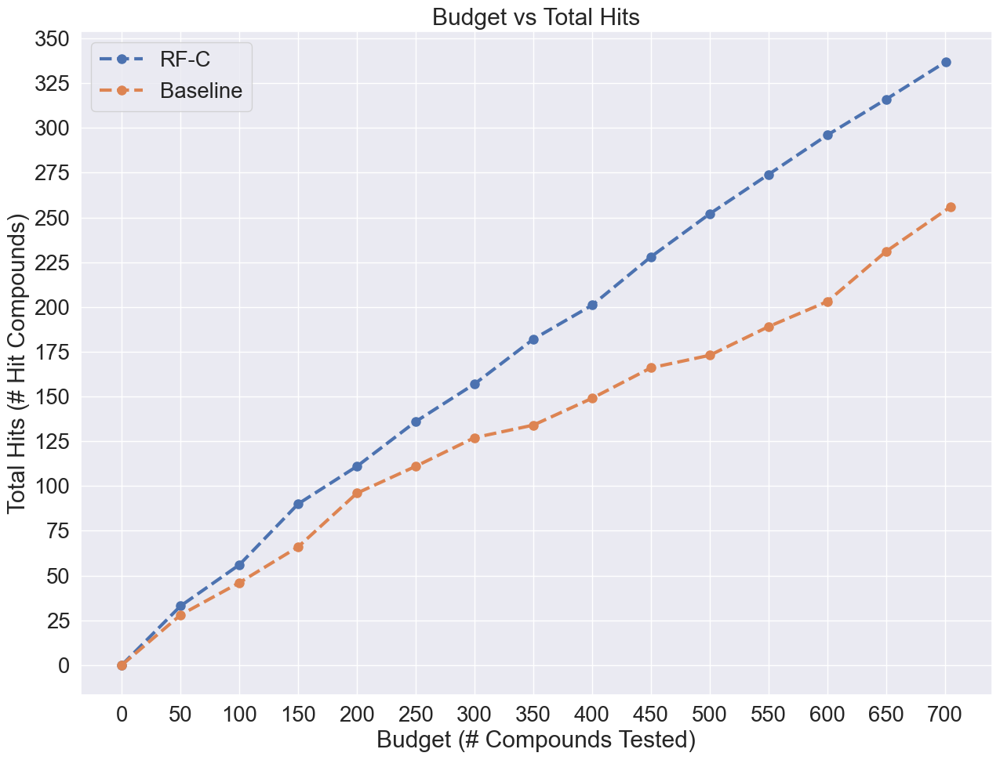

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_context("paper")
sns.set(font_scale=1.8)

new_rc_params = {'text.usetex': False,
"svg.fonttype": 'none'
}
plt.rcParams.update(new_rc_params)

RF_all_ranked = res_df[res_df['Selection'].isin(['Prediction', 'Both'])].sort_values('rf_rank')
budget_arr = np.arange(0, RF_all_ranked.shape[0], 50)
budget_arr[-1] = RF_all_ranked.shape[0]
total_hits_arr = np.zeros_like(budget_arr)
for i, b in enumerate(budget_arr):
    total_hits_arr[i] = RF_all_ranked.iloc[:b,:]['Hit'].sum()

plt.figure(figsize=(15,11))
plt.plot(budget_arr, total_hits_arr, linestyle='--', marker='o', markersize=8, linewidth=3)

BL_all_ranked = res_df[res_df['Selection'].isin(['Baseline', 'Both'])].sort_values('baseline_rank')
budget_arr = np.arange(0, BL_all_ranked.shape[0], 50)
budget_arr[-1] = BL_all_ranked.shape[0]
total_hits_arr = np.zeros_like(budget_arr)
for i, b in enumerate(budget_arr):
    total_hits_arr[i] = BL_all_ranked.iloc[:b,:]['Hit'].sum()

plt.plot(budget_arr, total_hits_arr, linestyle='--', marker='o', markersize=8, linewidth=3)
plt.xticks(np.arange(0, 750, 50))
plt.yticks(np.arange(0, 351, 25))
plt.xlabel('Budget (# Compounds Tested)')
plt.ylabel('Total Hits (# Hit Compounds)')
plt.legend(['RF-C', 'Baseline'])
plt.title('Budget vs Total Hits')

plt.savefig('./tmp_figures/prosp_budget_vs_hits.png')
plt.savefig('./tmp_figures/prosp_budget_vs_hits.svg')
plt.show()

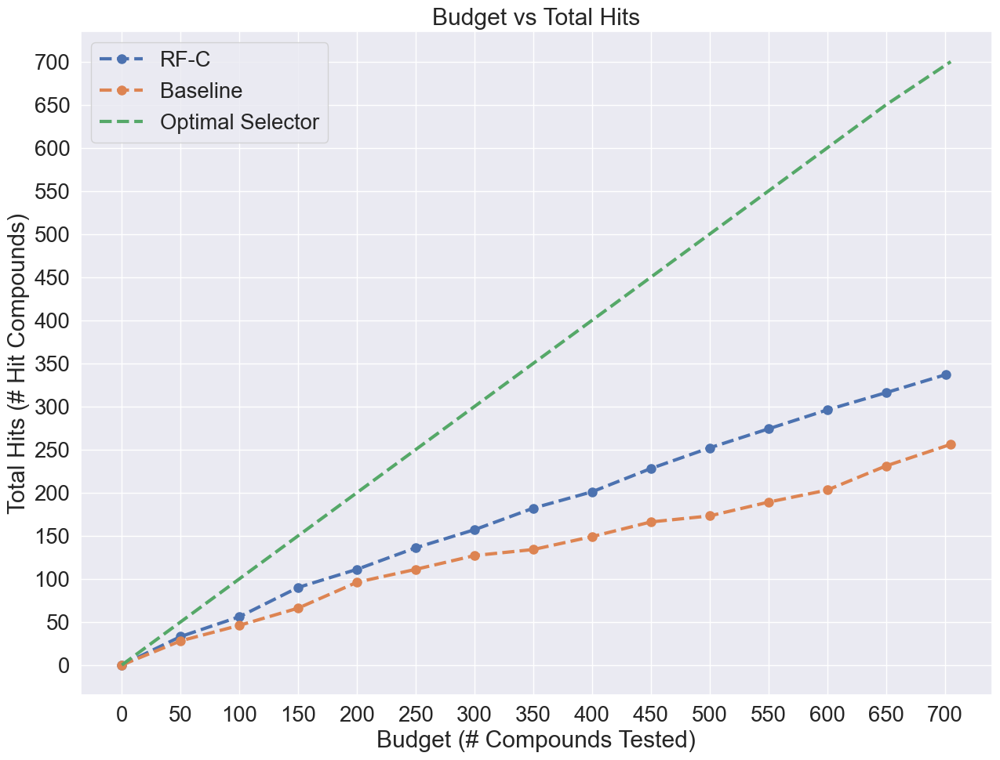

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_context("paper")
sns.set(font_scale=1.8)

new_rc_params = {'text.usetex': False,
"svg.fonttype": 'none'
}
plt.rcParams.update(new_rc_params)

RF_all_ranked = res_df[res_df['Selection'].isin(['Prediction', 'Both'])].sort_values('rf_rank')
budget_arr = np.arange(0, RF_all_ranked.shape[0], 50)
budget_arr[-1] = RF_all_ranked.shape[0]
total_hits_arr = np.zeros_like(budget_arr)
for i, b in enumerate(budget_arr):
    total_hits_arr[i] = RF_all_ranked.iloc[:b,:]['Hit'].sum()

plt.figure(figsize=(15,11))
plt.plot(budget_arr, total_hits_arr, linestyle='--', marker='o', markersize=8, linewidth=3)

BL_all_ranked = res_df[res_df['Selection'].isin(['Baseline', 'Both'])].sort_values('baseline_rank')
budget_arr = np.arange(0, BL_all_ranked.shape[0], 50)
budget_arr[-1] = BL_all_ranked.shape[0]
total_hits_arr = np.zeros_like(budget_arr)
for i, b in enumerate(budget_arr):
    total_hits_arr[i] = BL_all_ranked.iloc[:b,:]['Hit'].sum()

plt.plot(budget_arr, total_hits_arr, linestyle='--', marker='o', markersize=8, linewidth=3)
plt.plot(budget_arr, np.linspace(0, 700, 750//50), linestyle='--', markersize=8, linewidth=3)
plt.xticks(np.arange(0, 750, 50))
plt.yticks(np.arange(0, 750, 50))
plt.xlabel('Budget (# Compounds Tested)')
plt.ylabel('Total Hits (# Hit Compounds)')
plt.legend(['RF-C', 'Baseline', 'Optimal Selector'])
plt.title('Budget vs Total Hits')

plt.savefig('./tmp_figures/prosp_budget_vs_hits_v2.png')
plt.savefig('./tmp_figures/prosp_budget_vs_hits_v2.svg')
plt.show()

---
## Similarity of prospective to closest training actives

,Prospective Mol,Nearest Training Active,Tanimoto Distance,Is Hit?,Selection
0,,,0.567568,1,RF-C
1,,,0.564103,1,RF-C
2,,,0.552632,1,RF-C
3,,,0.551724,0,RF-C
4,,,0.551724,0,RF-C
5,,,0.551724,0,RF-C
6,,,0.550000,1,RF-C
7,,,0.548387,0,RF-C
8,,,0.548387,0,RF-C
9,,,0.547619,0,RF-C

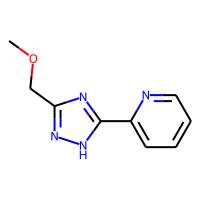
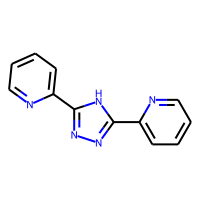
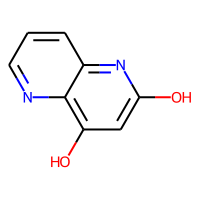
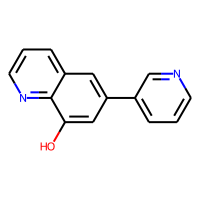
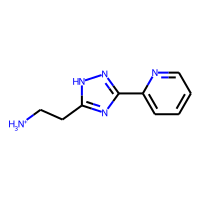
...
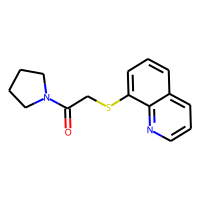
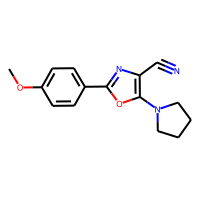
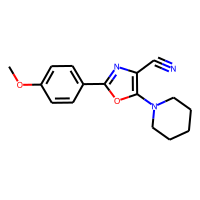
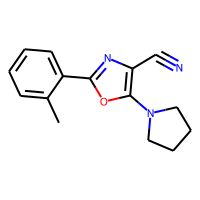
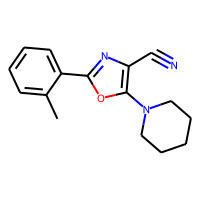

In [9]:
from sklearn.metrics import pairwise_distances, pairwise_distances_argmin
from rdkit import Chem
from rdkit.Chem.Draw import IPythonConsole 
from rdkit.Chem.Draw.MolDrawing import MolDrawing, DrawingOptions
from rdkit.Chem import PandasTools
from IPython.core.display import HTML
from rdkit.Chem import AllChem
PandasTools.RenderImagesInAllDataFrames(images=True)
DrawingOptions.atomLabelFontSize = 55
DrawingOptions.dotsPerAngstrom = 100
DrawingOptions.bondLineWidth = 3.0
from rdkit.Chem import rdFMCS

def show(df): # see issue: https://github.com/rdkit/rdkit/issues/2673
    return HTML(df.to_html())

def get_sim_df(train_df, prosp_df):
    X_train_actives = np.vstack([np.fromstring(x, 'u1') - ord('0') for x in train_df['1024 MorganFP Radius 2']]).astype(float)
    X_prosp = np.vstack([np.fromstring(x, 'u1') - ord('0') for x in prosp_df['1024 MorganFP Radius 2']]).astype(float)
    train_prosp_tandist = pairwise_distances(X_prosp, X_train_actives, metric='jaccard')
    sim_info = []
    for i in range(train_prosp_tandist.shape[0]):
        prosp_smiles = prosp_df['rdkit SMILES'].iloc[i]; prosp_mol = Chem.MolFromSmiles(prosp_smiles);
        closest_active_idx = np.argmin(train_prosp_tandist[i,:]); 
        dist = train_prosp_tandist[i,closest_active_idx]
        train_smiles = train_df['rdkit SMILES'].iloc[closest_active_idx]; train_mol = Chem.MolFromSmiles(train_smiles);

        # try to align mols
        try:
            mcs = rdFMCS.FindMCS([train_mol, prosp_mol], ringMatchesRingOnly=True, completeRingsOnly=True)
            template = Chem.MolFromSmarts(mcs.smartsString)
            AllChem.Compute2DCoords(template)
            AllChem.GenerateDepictionMatching2DStructure(train_mol, template)
            AllChem.GenerateDepictionMatching2DStructure(prosp_mol, template)
        except:
            pass
        
        sim_info.append((prosp_mol, train_mol, dist, prosp_df['Hit'].iloc[i], prosp_df['Selection'].iloc[i]))
        
    sim_df = pd.DataFrame(data=sim_info, 
                          columns=['Prospective Mol', 'Nearest Training Active', 'Tanimoto Distance', 'Is Hit?', 'Selection'])
    sim_df = sim_df.sort_values('Tanimoto Distance', ascending=False).reset_index(drop=True)
    sim_df.loc[sim_df['Selection'] == 'Prediction', 'Selection'] = 'RF-C'
    return sim_df

train_actives = train_df[train_df['Hit'] == 1]
sim_df = get_sim_df(train_actives, res_df)
show(sim_df)

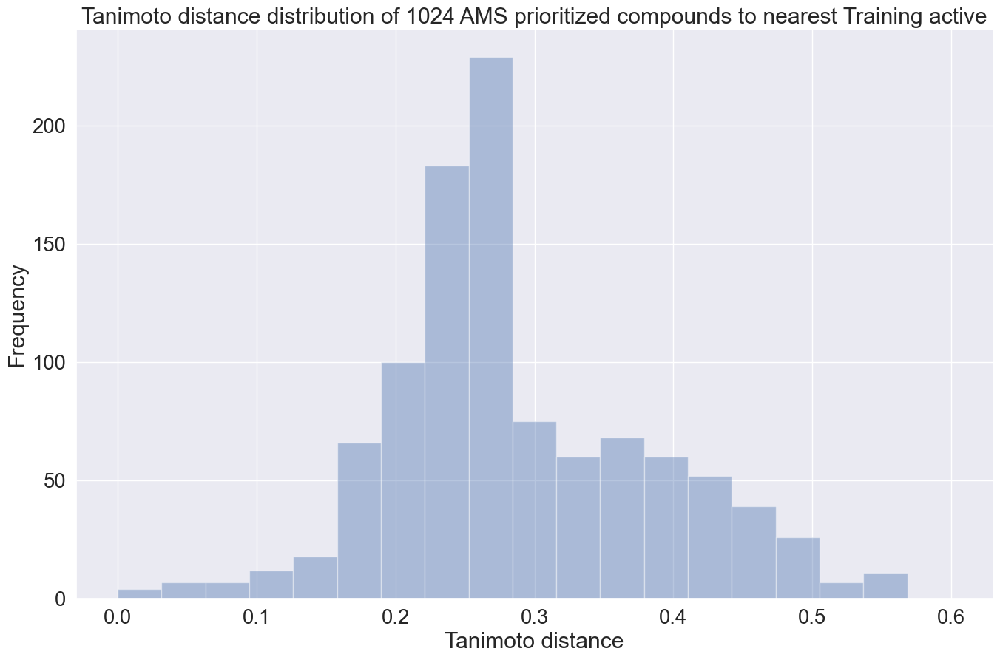

In [10]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
sns.set_context("paper");sns.set(font_scale=1.8);figsize=(16, 10)

new_rc_params = {'text.usetex': False,
"svg.fonttype": 'none'
}
plt.rcParams.update(new_rc_params)

bin_range=np.linspace(0, 0.6, 20)
plt.figure(figsize=figsize)
sns.distplot(sim_df['Tanimoto Distance'].values, bins=bin_range, norm_hist=False, kde=False)  
plt.title('Tanimoto distance distribution of 1024 AMS prioritized compounds to nearest Training active')
plt.xlabel('Tanimoto distance'); plt.ylabel('Frequency');
plt.show()

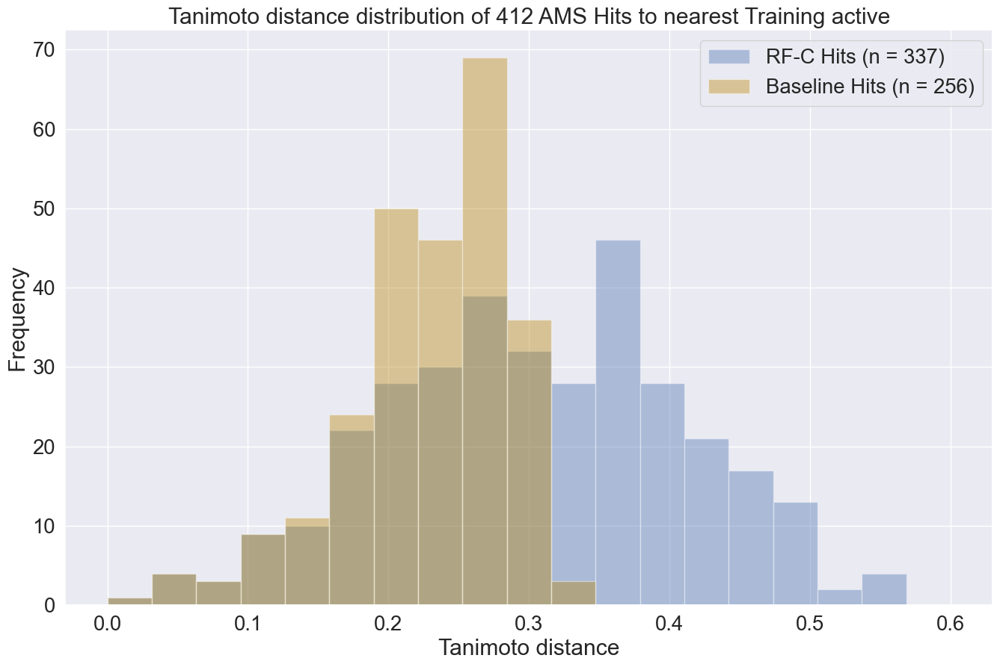

Median dist of RF-C: 0.3055555555555556.
Median dist of Baseline: 0.2391304347826087.


In [11]:
plt.figure(figsize=figsize)
rfc_hits_dist = sim_df[(sim_df['Is Hit?'] == 1) & (sim_df['Selection'].isin(['RF-C', 'Both']))]['Tanimoto Distance'].values
bl_hits_dist = sim_df[(sim_df['Is Hit?'] == 1) & (sim_df['Selection'].isin(['Baseline', 'Both']))]['Tanimoto Distance'].values

sns.distplot(rfc_hits_dist, bins=bin_range, norm_hist=False, kde=False)  
sns.distplot(bl_hits_dist, bins=bin_range, norm_hist=False, kde=False, color='darkgoldenrod')  

plt.title('Tanimoto distance distribution of 412 AMS Hits to nearest Training active')
plt.xlabel('Tanimoto distance'); plt.ylabel('Frequency');
plt.legend(['RF-C Hits (n = {})'.format(rfc_hits_dist.shape[0]), 
            'Baseline Hits (n = {})'.format(bl_hits_dist.shape[0])])

plt.savefig('./tmp_figures/ams_hits_selection_tandist.png')
plt.savefig('./tmp_figures/ams_hits_selection_tandist.svg')
plt.show()
print('Median dist of RF-C: {}.'.format(np.median(rfc_hits_dist)))
print('Median dist of Baseline: {}.'.format(np.median(bl_hits_dist)))

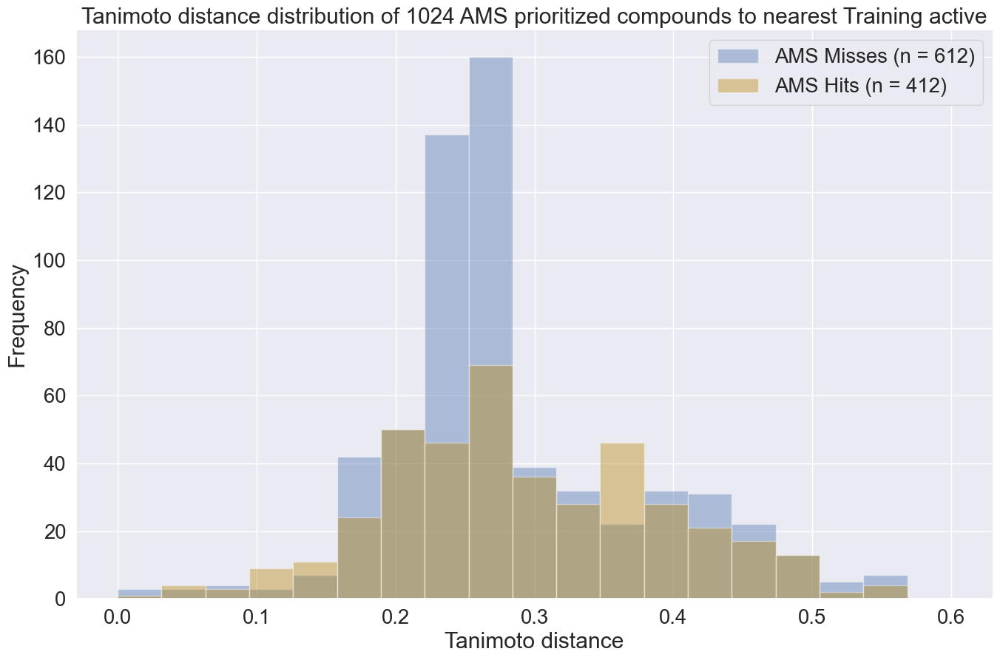

In [12]:
plt.figure(figsize=figsize)
prosp_hits_dist = sim_df[sim_df['Is Hit?'] == 1]['Tanimoto Distance'].values
prosp_misses_dist = sim_df[sim_df['Is Hit?'] == 0]['Tanimoto Distance'].values

sns.distplot(prosp_misses_dist, bins=bin_range, norm_hist=False, kde=False)  
sns.distplot(prosp_hits_dist, bins=bin_range, norm_hist=False, kde=False, color='darkgoldenrod') 
plt.title('Tanimoto distance distribution of 1024 AMS prioritized compounds to nearest Training active')
plt.xlabel('Tanimoto distance'); plt.ylabel('Frequency');
plt.legend(['AMS Misses (n = {})'.format(prosp_misses_dist.shape[0]), 
            'AMS Hits (n = {})'.format(prosp_hits_dist.shape[0])])

plt.savefig('./tmp_figures/ams_all_hits_misses_tandist.png')
plt.savefig('./tmp_figures/ams_all_hits_misses_tandist.svg')
plt.show()

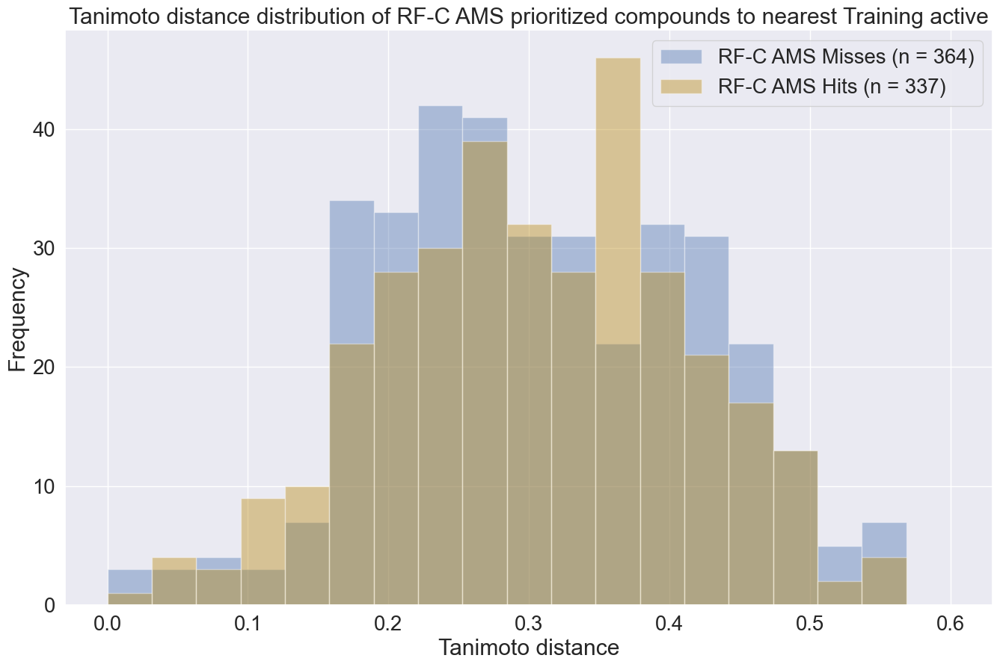

In [13]:
plt.figure(figsize=figsize)
rfc_hits_dist = sim_df[(sim_df['Is Hit?'] == 1) & (sim_df['Selection'].isin(['RF-C', 'Both']))]['Tanimoto Distance'].values
rfc_misses_dist = sim_df[(sim_df['Is Hit?'] == 0) & (sim_df['Selection'].isin(['RF-C', 'Both']))]['Tanimoto Distance'].values

sns.distplot(rfc_misses_dist, bins=bin_range, norm_hist=False, kde=False)  
sns.distplot(rfc_hits_dist, bins=bin_range, norm_hist=False, kde=False, color='darkgoldenrod') 

plt.title('Tanimoto distance distribution of RF-C AMS prioritized compounds to nearest Training active')
plt.xlabel('Tanimoto distance'); plt.ylabel('Frequency');
plt.legend(['RF-C AMS Misses (n = {})'.format(rfc_misses_dist.shape[0]), 
            'RF-C AMS Hits (n = {})'.format(rfc_hits_dist.shape[0])])

plt.savefig('./tmp_figures/ams_rfc_hits_misses_tandist.png')
plt.savefig('./tmp_figures/ams_rfc_hits_misses_tandist.svg')
plt.show()

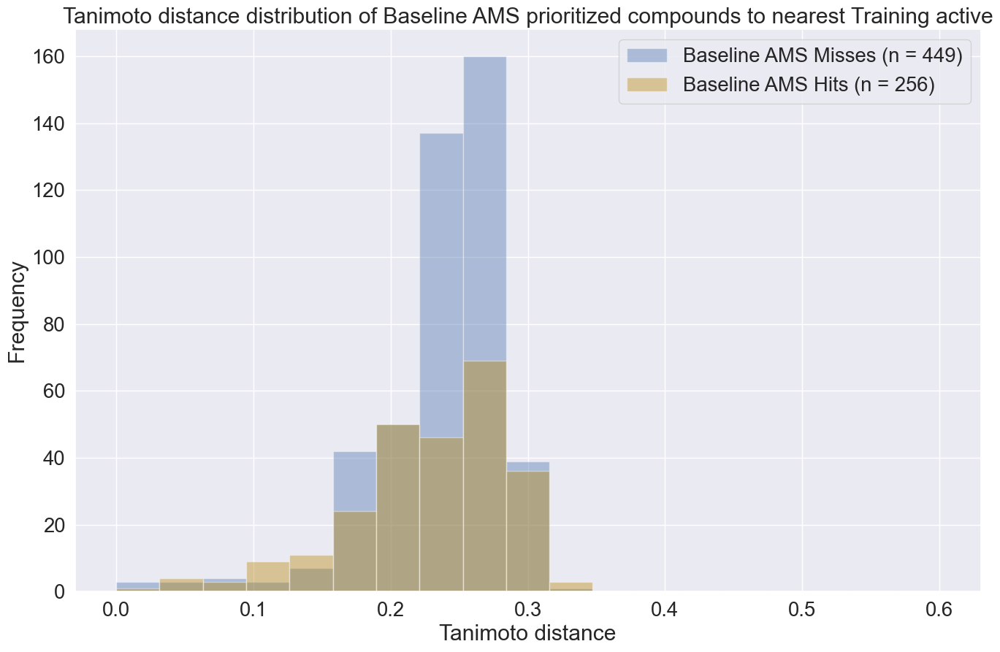

In [14]:
plt.figure(figsize=figsize)
bl_hits_dist = sim_df[(sim_df['Is Hit?'] == 1) & (sim_df['Selection'].isin(['Baseline', 'Both']))]['Tanimoto Distance'].values
bl_misses_dist = sim_df[(sim_df['Is Hit?'] == 0) & (sim_df['Selection'].isin(['Baseline', 'Both']))]['Tanimoto Distance'].values

sns.distplot(bl_misses_dist, bins=bin_range, norm_hist=False, kde=False)#, color='maroon')  
sns.distplot(bl_hits_dist, bins=bin_range, norm_hist=False, kde=False, color='darkgoldenrod')#, color='green')  

plt.title('Tanimoto distance distribution of Baseline AMS prioritized compounds to nearest Training active')
plt.xlabel('Tanimoto distance'); plt.ylabel('Frequency');
plt.legend(['Baseline AMS Misses (n = {})'.format(bl_misses_dist.shape[0]), 
            'Baseline AMS Hits (n = {})'.format(bl_hits_dist.shape[0])])

plt.savefig('./tmp_figures/ams_bl_hits_misses_tandist.png')
plt.savefig('./tmp_figures/ams_bl_hits_misses_tandist.svg')
plt.show()

---
## Relationship between prospective cost and activity

<Figure size 1600x1000 with 0 Axes>

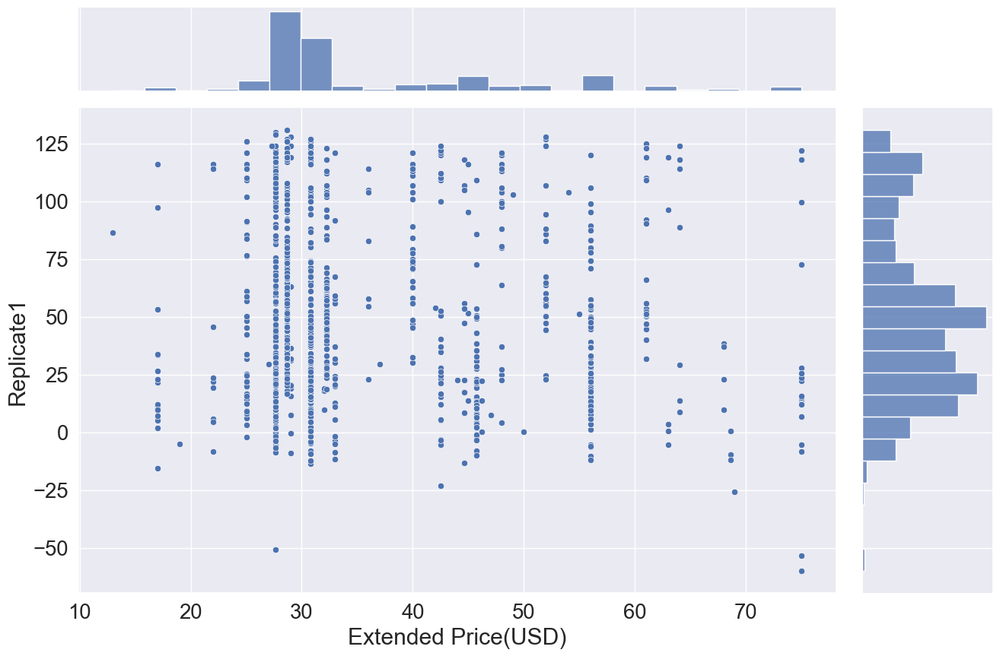

In [15]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_context("paper");sns.set(font_scale=1.8);figsize=(16, 10)

new_rc_params = {'text.usetex': False,
"svg.fonttype": 'none'
}
plt.rcParams.update(new_rc_params)

figsize=(16, 10)
plt.figure(figsize=figsize)
g = sns.jointplot(x="Extended Price(USD)", y="Replicate1", data=res_df)
g.fig.set_figwidth(figsize[0]); g.fig.set_figheight(figsize[1])
plt.show()

<Figure size 1600x1000 with 0 Axes>

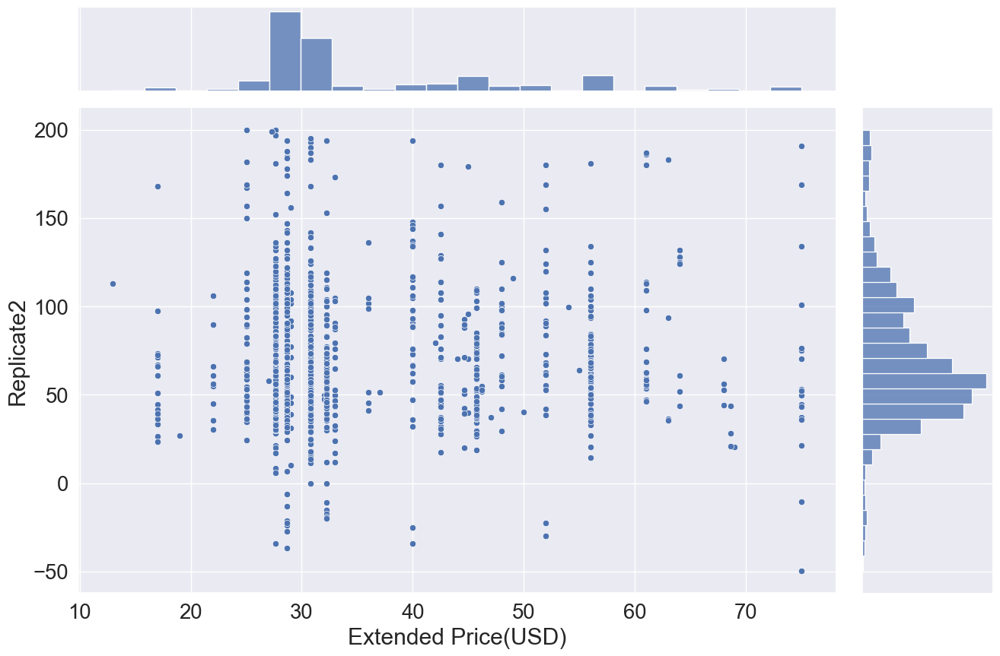

In [16]:
plt.figure(figsize=figsize)
g = sns.jointplot(x="Extended Price(USD)", y="Replicate2", data=res_df)
g.fig.set_figwidth(figsize[0]); g.fig.set_figheight(figsize[1])
plt.show()

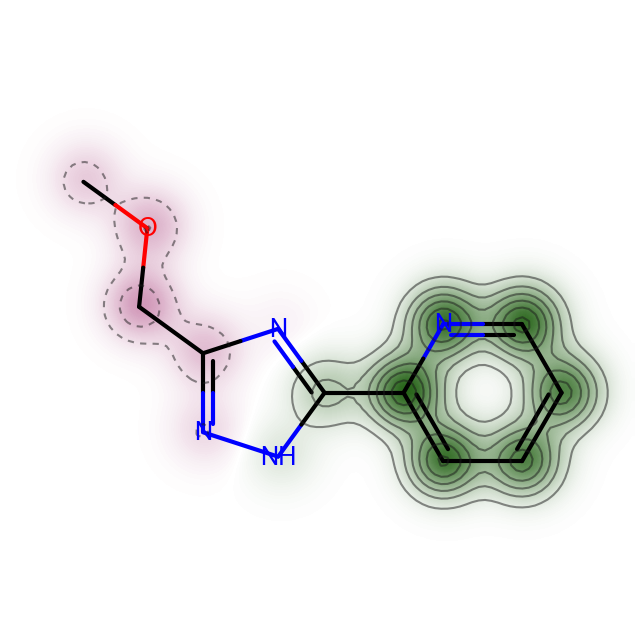

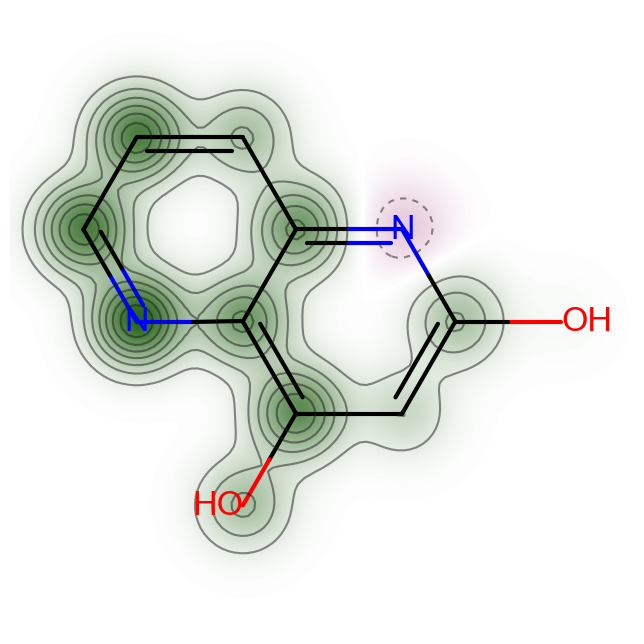

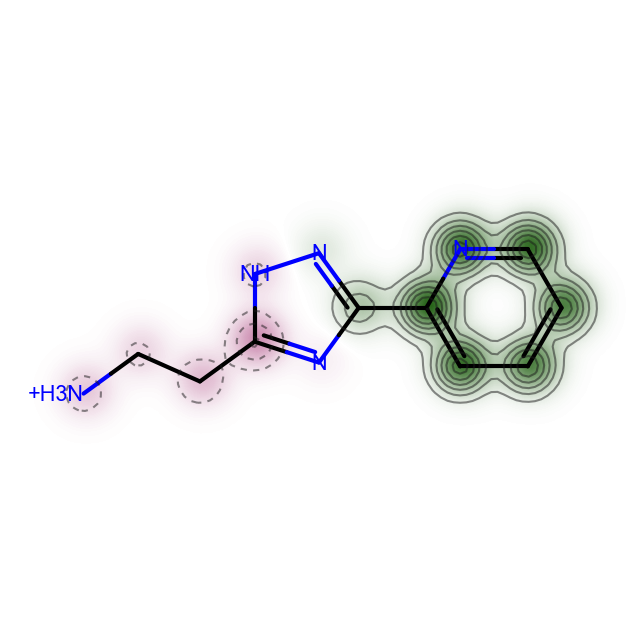

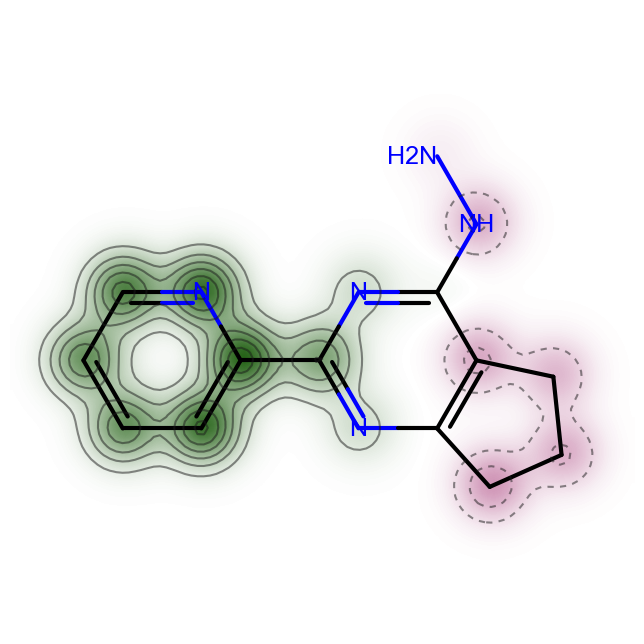

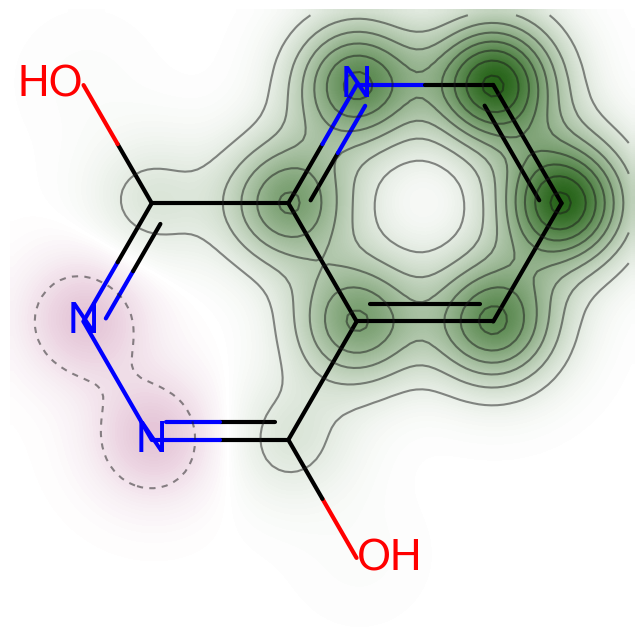

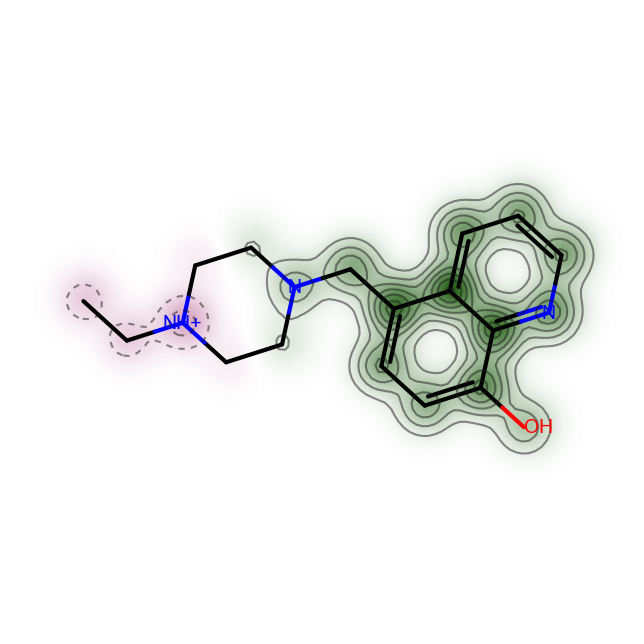

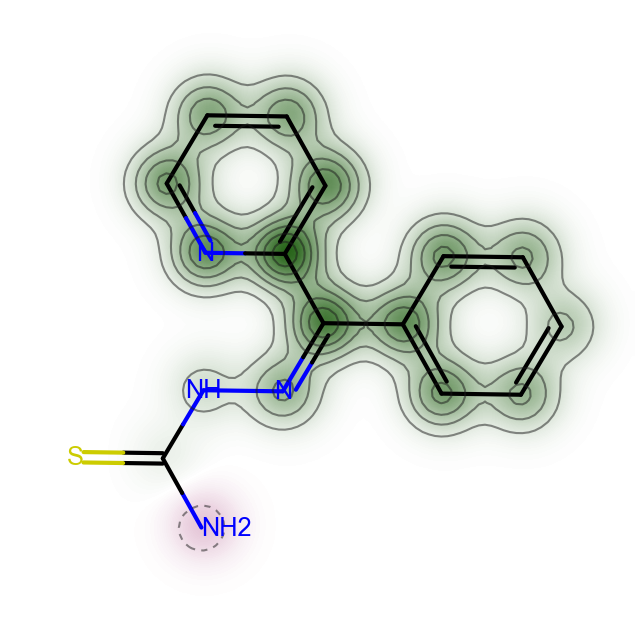

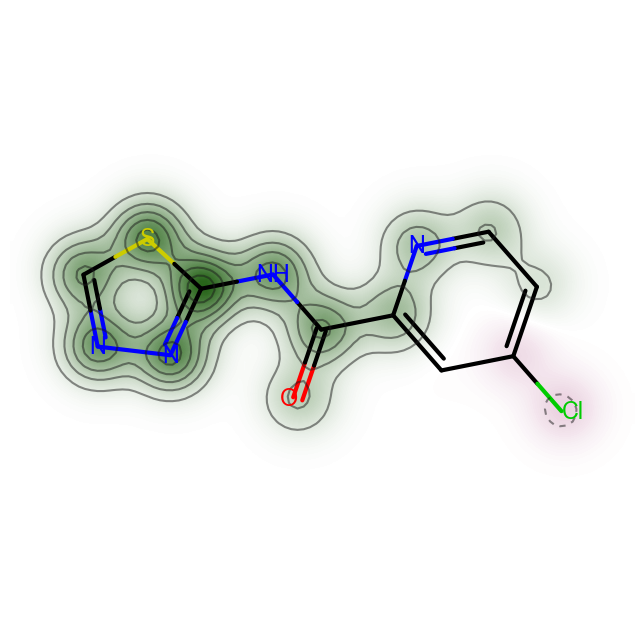

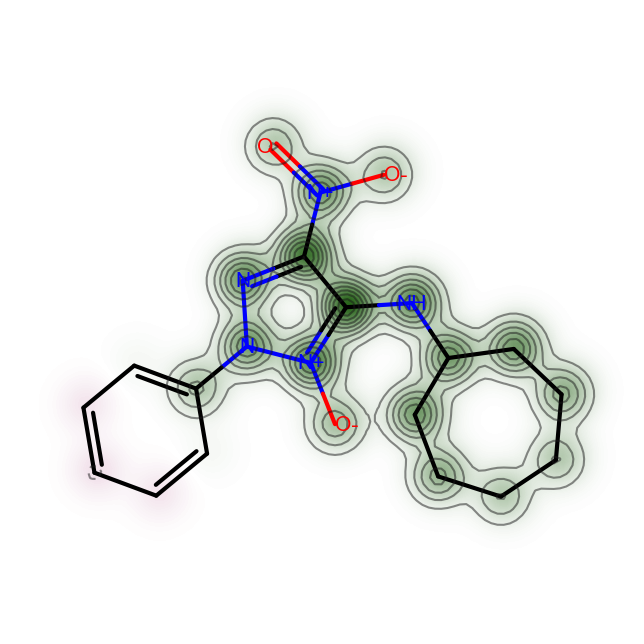

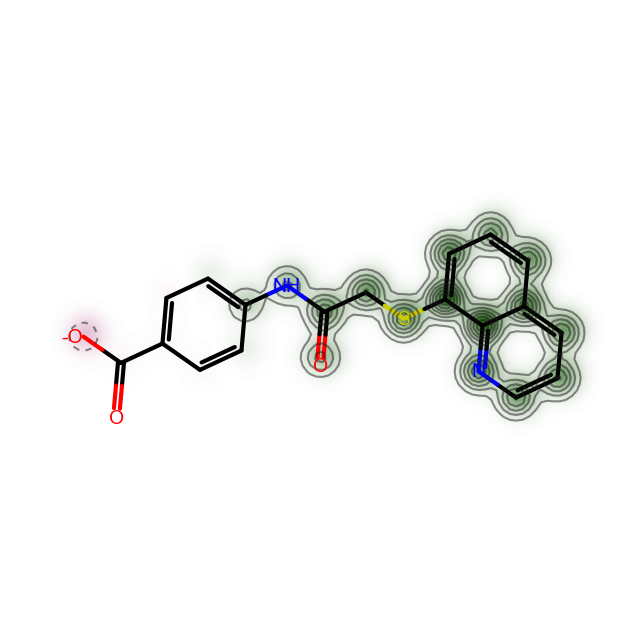

In [17]:
x = sim_df[(sim_df['Is Hit?'] == 1) & (sim_df['Selection'].isin(['RF-C', 'Both']))].iloc[:5,:-2].copy()
y = sim_df[(sim_df['Is Hit?'] == 1) & (sim_df['Selection'].isin(['Baseline', 'Both']))].iloc[:5,:-2].copy()

from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem.Draw import DrawingOptions
from rdkit.Chem.Draw import SimilarityMaps
FP_radius=2

for i in range(x.shape[0]):
    Draw.MolToFile(x.iloc[i,0], "./prosp_hits/rf_{}{}.svg".format(i, 0))
    Draw.MolToFile(x.iloc[i,1], "./prosp_hits/rf_{}{}.svg".format(i, 1))
    
    prosp_mol = x.iloc[i,0]
    train_mol = x.iloc[i,1]
    
    sim_func = (lambda a, b: SimilarityMaps.GetMorganFingerprint(a, atomId=b, fpType='bv', radius=FP_radius, nBits=1024))
    fig, maxweight = SimilarityMaps.GetSimilarityMapForFingerprint(train_mol, prosp_mol, sim_func)
        
    fig.savefig("./prosp_hits/rf_{}{}.svg".format(i, 3), bbox_inches='tight')
    
for i in range(y.shape[0]):
    Draw.MolToFile(y.iloc[i,0], "./prosp_hits/bl_{}{}.svg".format(i, 0))
    Draw.MolToFile(y.iloc[i,1], "./prosp_hits/bl_{}{}.svg".format(i, 1))
    
    prosp_mol = y.iloc[i,0]
    train_mol = y.iloc[i,1]
    
    sim_func = (lambda a, b: SimilarityMaps.GetMorganFingerprint(a, atomId=b, fpType='bv', radius=FP_radius, nBits=1024))
    fig, maxweight = SimilarityMaps.GetSimilarityMapForFingerprint(train_mol, prosp_mol, sim_func)
        
    fig.savefig("./prosp_hits/bl_{}{}.svg".format(i, 3), bbox_inches='tight')

,Prospective Mol,Nearest Training Active,Tanimoto Distance,Is Hit?,Selection
0,,,0.567568,1,RF-C
1,,,0.564103,1,RF-C
2,,,0.552632,1,RF-C
6,,,0.550000,1,RF-C
11,,,0.531250,1,RF-C

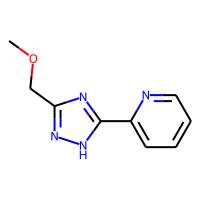
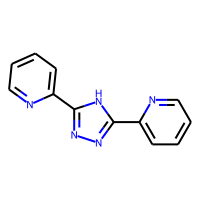
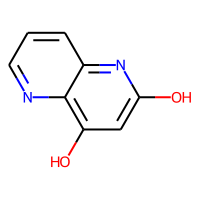
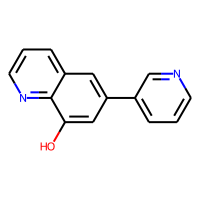
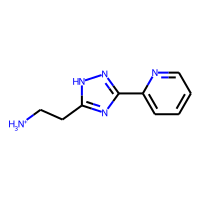
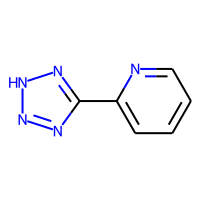
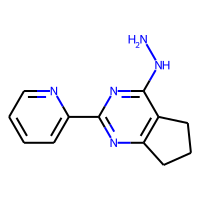
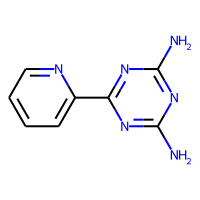
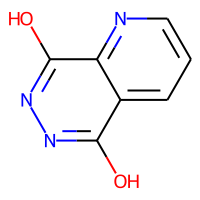
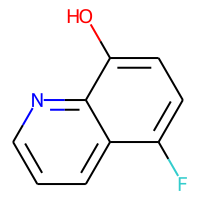

In [18]:
show(sim_df[(sim_df['Is Hit?'] == 1) & (sim_df['Selection'].isin(['RF-C', 'Both']))].iloc[:5,:])

,Prospective Mol,Nearest Training Active,Tanimoto Distance,Is Hit?,Selection
317,,,0.318182,1,Both
320,,,0.317073,1,Both
322,,,0.315789,1,Both
323,,,0.314815,1,Baseline
327,,,0.313725,1,Both

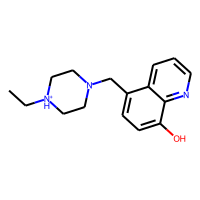
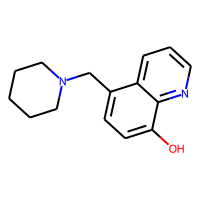
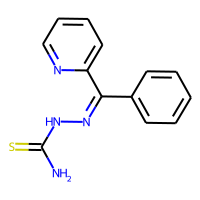
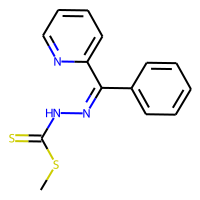
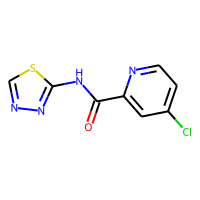
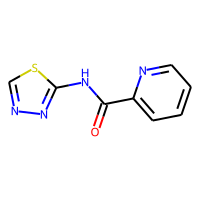
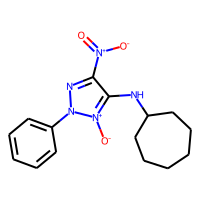
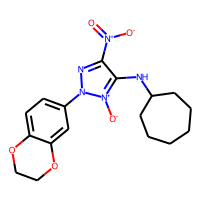
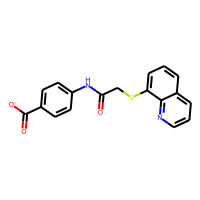
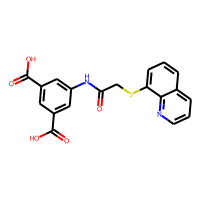

In [19]:
show(sim_df[(sim_df['Is Hit?'] == 1) & (sim_df['Selection'].isin(['Baseline', 'Both']))].iloc[:5,:])

In [20]:
a = res_df[['baseline_rank', 'rf_rank', 'Selection']]

rf_only = a[a['Selection'] == 'Prediction']
bl_only = a[a['Selection'] == 'Baseline']
both = a[a['Selection'] == 'Both']

In [21]:
res_df = pd.read_csv('../datasets/Zenodo/v1/ams_order_results.csv.gz')
top_real_clustering = pd.read_csv('../datasets/Zenodo/v1/enamine_final_list.csv.gz')

In [24]:
x = pd.concat([top_real_clustering['rf_preds'].describe().to_frame(), res_df['rf_preds'].describe().to_frame()], axis=1)
x.columns = ['Enamine', 'AMS']
show(x)

,Enamine,AMS
count,100.000000,1024.000000
mean,0.206519,0.231285
std,0.035897,0.125423
min,0.174000,0.004125
25%,0.184248,0.141953
50%,0.194497,0.239069
75%,0.216185,0.300984
max,0.397000,0.716500


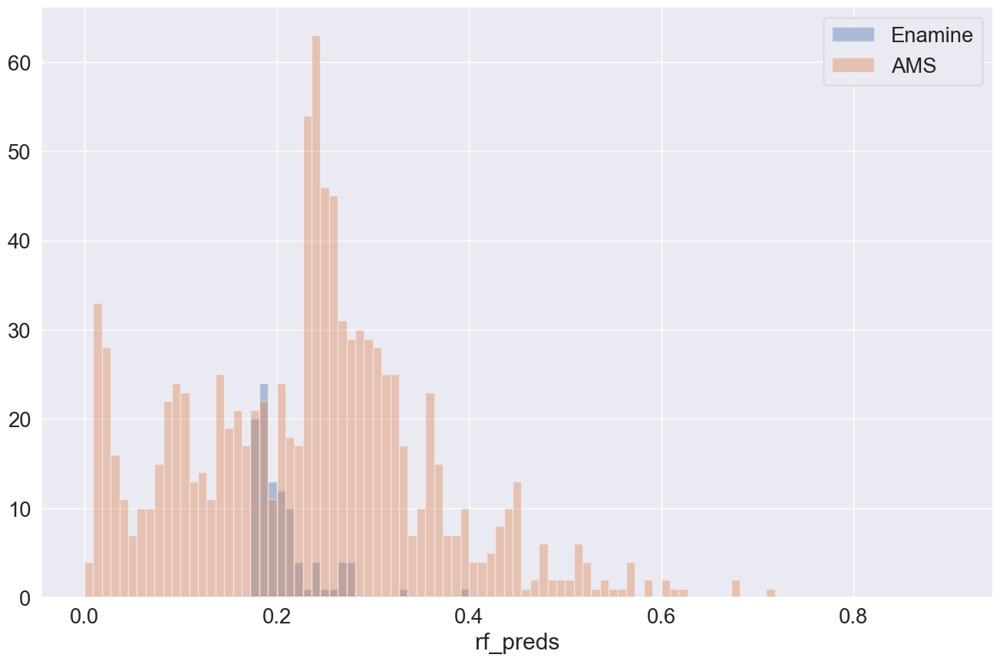

In [23]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_context("paper");sns.set(font_scale=1.8);figsize=(16, 10)

kde=False
bin_range=np.linspace(0.0, 0.9, 100)
plt.figure(figsize=figsize)
sns.distplot(top_real_clustering['rf_preds'], bins=bin_range, norm_hist=False, kde=kde)  
sns.distplot(res_df['rf_preds'], bins=bin_range, norm_hist=False, kde=kde)  
plt.legend(['Enamine', 'AMS'])